# Bayesian Audiogram Estimation (new)

## Overview
This implementation presents a novel approach to pure-tone audiometry using Bayesian inference. Unlike traditional methods like the Modified Hughson-Westlake procedure that follow fixed rules for threshold estimation, this approach maintains and updates probability distributions of likely threshold values based on subject responses.

## Key Features

### Probabilistic Framework
- Maintains full probability distributions over possible threshold values (-10 to 120 dB)
- Updates beliefs about threshold locations using Bayes' rule after each response
- Provides uncertainty estimates along with threshold estimates
- Handles false positives and negatives probabilistically

### Adaptive Test Level Selection
- Chooses test levels to maximize information gain
- Balances exploration and exploitation
- Adapts step sizes based on current uncertainty and test phase
- Respects clinical safety constraints (e.g., maximum step sizes)

### Prior Knowledge Integration
- Uses uniform priors when no information is available
- Incorporates information from previously tested frequencies
- Weights influence by octave distance between frequencies
- Maintains separate phases (initial, ascending, descending) for optimal testing

## Implementation Details

### Test Phases
1. **Initial Phase**: 
   - Aggressive stepping to find first response
   - Starts at 40 dB for uniform priors
   - Maximum step size of 20 dB below 80 dB

2. **Descending/Ascending Phases**:
   - More conservative step sizes based on information gain
   - Maximum step size of 5 dB above 80 dB
   - Phase transitions based on responses

### Safety Constraints
- Never starts above 80 dB regardless of prior
- Maximum step size of 20 dB when crossing into high-level region
- Maximum level of 85 dB when stepping up from below 80 dB
- 5 dB maximum steps above 80 dB

### Convergence Criteria
- Based on uncertainty in threshold estimate
- Maximum number of trials per frequency
- Requires initial response to be found
- Considers both measurement uncertainty and response variability

## Advantages Over Traditional Methods
1. Provides uncertainty estimates with each threshold
2. Makes optimal use of previous frequency information
3. Adapts to subject performance characteristics
4. Handles response errors probabilistically
5. Potentially reduces number of required trials

## Usage Example
```python
# Create simulated hearing profile with mild to moderate hearing loss
hearing_profile = {
    250: 10,   
    500: 15,   
    1000: 20,  
    2000: 30,  
    4000: 45,  
    8000: 50   
}
# Configure response model
response_params = {
    'slope': 0.2,      
    'guess_rate': 0.01,  
    'lapse_rate': 0.01   
}
# Initialize and run test
audiometry = BayesianPureToneAudiometry(
    hearing_profile_data=hearing_profile,
    response_model_params=response_params,
    test_frequencies=[1000, 2000, 4000, 8000, 500, 250],
    random_state=42,
    fp_rate=0.01,
    fn_rate=0.02
)
# Get results
results = audiometry.perform_test()
thresholds = results['thresholds']
uncertainties = results['uncertainties']
progression_patterns = results['progression_patterns']
pdf_histories = results['pdf_history']
```

This implementation offers a more sophisticated and theoretically grounded approach to audiometric testing while maintaining clinical safety standards and practical usability.

In [50]:
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 3000

In [1]:
import sys
from typing import Dict, List, Tuple, Union, Optional
import numpy as np
from scipy.stats import norm
from scipy.signal import convolve
from enum import Enum

# Local imports
sys.path.append( '../src/' )
sys.path.append( '../src/simulations/models' )
sys.path.append( '../src/simulations/constants' )
from response_model import HearingResponseModel
from defaults import *

class BayesianPureToneAudiometry:
    class TestPhase(Enum):
        INITIAL = 'initial'
        ASCENDING = 'ascending'
        DESCENDING = 'descending'

    def __init__(
        self,
        hearing_profile_data: dict,
        response_model_params: Optional[dict] = None,
        test_frequencies: Optional[List[int]] = None,
        max_trials_per_freq: int = 20,
        convergence_threshold_db: float = 5.0,
        grid_resolution_db: float = 1.0,
        fp_rate: float = 0.02,  # False positive rate
        fn_rate: float = 0.05,  # False negative rate
        ascending_weight: float = 1.0,  # Relative weight for ascending trials
        descending_weight: float = 1.0,  # Relative weight for descending trials
        random_state: Optional[int] = None
    ):
        """
        Initialize enhanced Bayesian pure-tone audiometry testing.
        """
        self.hearing_profile_data = hearing_profile_data
        self.response_model = HearingResponseModel(**(response_model_params or {}))
        self.test_frequencies = test_frequencies or [250, 500, 1000, 2000, 4000, 8000]
        self.max_trials = max_trials_per_freq
        self.convergence_threshold = convergence_threshold_db
        self.grid_resolution = grid_resolution_db
        self.fp_rate = fp_rate
        self.fn_rate = fn_rate
        self.ascending_weight = ascending_weight
        self.descending_weight = descending_weight
        self.rng = np.random.default_rng(random_state)
        
        # Initialize probability grids
        self.db_range = np.arange(-10, 121, self.grid_resolution)
        self.priors = {}
        self.posteriors = {}
        self.thresholds = {}
        self.uncertainties = {}
        self.progression_patterns = {}
        self.pdf_history = {}  # Track PDF evolution
        
    def _get_octave_influence(self, freq1: int, freq2: int) -> float:
        """
        Calculate influence weight based on octave distance between frequencies.
        Uses continuous decay rather than discrete categories.
        """
        octave_diff = abs(np.log2(freq1 / freq2))
        return np.exp(-octave_diff)  # Exponential decay with octave difference
        
    def _initialize_prior(self, frequency: int) -> np.ndarray:
        """
        Initialize prior with influence from all previously tested frequencies.
        """
        # Start with uniform prior
        prior = np.ones_like(self.db_range) / len(self.db_range)
        
        # Get all previously tested frequencies
        tested_freqs = list(self.posteriors.keys())
        if not tested_freqs:
            return prior
            
        # Combine influences from all previous frequencies
        influence = np.zeros_like(prior)
        total_weight = 0
        
        for tested_freq in tested_freqs:
            weight = self._get_octave_influence(frequency, tested_freq)
            total_weight += weight
            influence += weight * self.posteriors[tested_freq]
            
        if total_weight > 0:
            prior = (influence / total_weight + prior) / 2
            
        return prior / prior.sum()
        
    def _get_initial_level(self, prior: np.ndarray) -> float:
        """
        Determine initial test level based on prior distribution.
        """
        if np.allclose(prior, prior[0]):  # Uniform distribution
            return 40.0
            
        # Get weighted average of prior
        expected_threshold = np.sum(self.db_range * prior)
        
        # Apply clinical constraints
        if expected_threshold > 80:
            return 80.0
        return min(max(40.0, expected_threshold), 80.0)
        
    def _apply_step_constraints(
        self,
        current_level: float,
        proposed_level: float
    ) -> float:
        """
        Apply clinical step size constraints.
        """
        if current_level >= 80:
            # Already above 80, limit to 5 dB steps
            return current_level + np.clip(proposed_level - current_level, -5, 5)
        elif proposed_level > 80:
            # Moving into high-level region
            return min(85, current_level + 20)
        elif current_level < 80 and (proposed_level - current_level) > 20:
            # Below 80 but step too large
            return current_level + 20
        return proposed_level
        
    def _get_response_probability(
        self,
        stimulus_level: float,
        threshold: float,
        slope: float = 0.1
    ) -> float:
        """
        Get probability of response given stimulus level and threshold.
        Uses psychometric function (cumulative normal).
        """
        x = stimulus_level - threshold
        return norm.cdf(x * slope)
        
    def _get_entropy(self, distribution: np.ndarray) -> float:
        """Calculate Shannon entropy of distribution."""
        positive_probs = distribution[distribution > 0]
        return -np.sum(positive_probs * np.log2(positive_probs))
        
    def _estimate_threshold(self, posterior: np.ndarray) -> Tuple[float, float]:
        """
        Estimate threshold and uncertainty from posterior distribution.
        """
        threshold = np.sum(self.db_range * posterior)
        variance = np.sum(posterior * (self.db_range - threshold)**2)
        return threshold, np.sqrt(variance)

    def _update_posterior_with_error_rates(
        self,
        prior: np.ndarray,
        test_level: float,
        response: bool,
        phase: TestPhase
    ) -> np.ndarray:
        """
        Update posterior accounting for false positive/negative rates.
        """
        likelihoods = np.zeros_like(self.db_range)
        
        for i, threshold in enumerate(self.db_range):
            # Base response probability from psychometric function
            p_base = self._get_response_probability(test_level, threshold)
            
            # Adjust for false positives/negatives
            p_response = p_base * (1 - self.fn_rate) + (1 - p_base) * self.fp_rate
            
            # Apply phase-specific weighting
            if phase == self.TestPhase.ASCENDING:
                p_response *= self.ascending_weight
            elif phase == self.TestPhase.DESCENDING:
                p_response *= self.descending_weight
                
            likelihoods[i] = p_response if response else (1 - p_response)
            
        posterior = likelihoods * prior
        return posterior / posterior.sum()
        
    def _get_optimal_test_level_for_phase(
        self,
        posterior: np.ndarray,
        previous_level: Optional[float],
        phase: TestPhase
    ) -> float:
        """
        Get optimal test level considering test phase.
        """
        if phase == self.TestPhase.INITIAL:
            # Aggressive stepping to find first response
            if previous_level is None:
                return self._get_initial_level(posterior)
            elif previous_level < 80:
                return min(80, previous_level + 20)
            else:
                return min(120, previous_level + 5)
                
        # Calculate expected information gain for each possible level
        info_gains = np.zeros_like(self.db_range)
        
        for i, test_level in enumerate(self.db_range):
            # Skip invalid levels due to step constraints
            if previous_level is not None:
                constrained_level = self._apply_step_constraints(previous_level, test_level)
                if constrained_level != test_level:
                    continue
                    
            # Calculate expected information gain
            p_response = 0
            for threshold, prob in zip(self.db_range, posterior):
                response_prob = self._get_response_probability(test_level, threshold)
                # Adjust for errors
                response_prob = response_prob * (1 - self.fn_rate) + (1 - response_prob) * self.fp_rate
                p_response += prob * response_prob
                
            # Calculate expected entropy reduction
            h_current = self._get_entropy(posterior)
            h_yes = self._get_entropy(
                self._update_posterior_with_error_rates(
                    posterior, test_level, True, phase))
            h_no = self._get_entropy(
                self._update_posterior_with_error_rates(
                    posterior, test_level, False, phase))
                    
            info_gains[i] = h_current - (p_response * h_yes + (1 - p_response) * h_no)
            
        return self.db_range[np.argmax(info_gains)]
        
    def _test_frequency(self, frequency: int) -> Tuple[float, float, List]:
        """
        Perform Bayesian threshold estimation for single frequency.
        """
        prior = self._initialize_prior(frequency)
        posterior = prior
        progression = []
        pdf_history = []  # Track PDF evolution
        prev_level = None
        phase = self.TestPhase.INITIAL
        initial_response_found = False
        
        for trial in range(self.max_trials):
            # Get optimal test level for current phase
            proposed_level = self._get_optimal_test_level_for_phase(
                posterior, prev_level, phase)
            
            # Apply clinical constraints
            test_level = self._apply_step_constraints(
                prev_level if prev_level is not None else proposed_level,
                proposed_level)
            
            # Get response
            response = self.response_model.sample_response(
                test_level,
                self.hearing_profile_data[frequency],
                random_state=self.rng
            )
            
            # Update phase based on response
            if phase == self.TestPhase.INITIAL and response:
                phase = self.TestPhase.DESCENDING
                initial_response_found = True
            elif phase == self.TestPhase.DESCENDING and not response:
                phase = self.TestPhase.ASCENDING
            elif phase == self.TestPhase.ASCENDING and response:
                phase = self.TestPhase.DESCENDING
                
            # Update posterior with error rates
            posterior = self._update_posterior_with_error_rates(
                posterior, test_level, response, phase)
                
            # Record progression and PDF
            threshold_est, uncertainty = self._estimate_threshold(posterior)
            progression.append((test_level, response, threshold_est, uncertainty, phase.value))
            pdf_history.append(posterior.copy())
            
            # Check convergence
            if (initial_response_found and 
                uncertainty < self.convergence_threshold):
                break
                
            prev_level = test_level
            
        return threshold_est, uncertainty, progression, pdf_history
        
    def perform_test(self) -> Dict:
        """
        Perform complete audiometry test using enhanced Bayesian approach.
        """
        for freq in self.test_frequencies:
            threshold, uncertainty, progression, pdf_history = self._test_frequency(freq)
            
            self.thresholds[freq] = threshold
            self.uncertainties[freq] = uncertainty
            self.progression_patterns[freq] = progression
            self.pdf_history[freq] = pdf_history
            
            # Store final posterior for future frequencies
            if freq in self.posteriors:
                del self.posteriors[freq]
            self.posteriors[freq] = pdf_history[-1]
            
        return {
            'thresholds': self.thresholds,
            'uncertainties': self.uncertainties,
            'progression_patterns': self.progression_patterns,
            'pdf_history': self.pdf_history
        }


Test Results:

Thresholds (with uncertainties):
250 Hz: 8.2 dB ± 4.8 dB
500 Hz: 21.0 dB ± 4.7 dB
1000 Hz: 20.9 dB ± 4.5 dB
2000 Hz: 24.8 dB ± 4.8 dB
4000 Hz: 43.4 dB ± 4.5 dB
8000 Hz: 47.9 dB ± 4.8 dB

Trials per Frequency:
Frequency | Trials
--------------------
     250 |     12
     500 |      5
    1000 |     12
    2000 |      6
    4000 |     12
    8000 |     10

Trial Statistics:
Mean trials per frequency: 9.5
Standard deviation: 2.9
Range: 5 - 12

Progression for 1000 Hz:
Level | Response | Est. Threshold | Uncertainty | Phase
-----------------------------------------------------------------
 40 dB | True  |          16.8 |       18.2 | descending
 17 dB | False |          29.7 |       16.0 | ascending
 29 dB | False |          38.6 |       15.7 | ascending
 40 dB | True  |          31.8 |        8.5 | descending
 31 dB | True  |          27.5 |        7.4 | descending
 26 dB | False |          30.5 |        6.3 | ascending
 30 dB | True  |          27.8 |        5.8 | descen

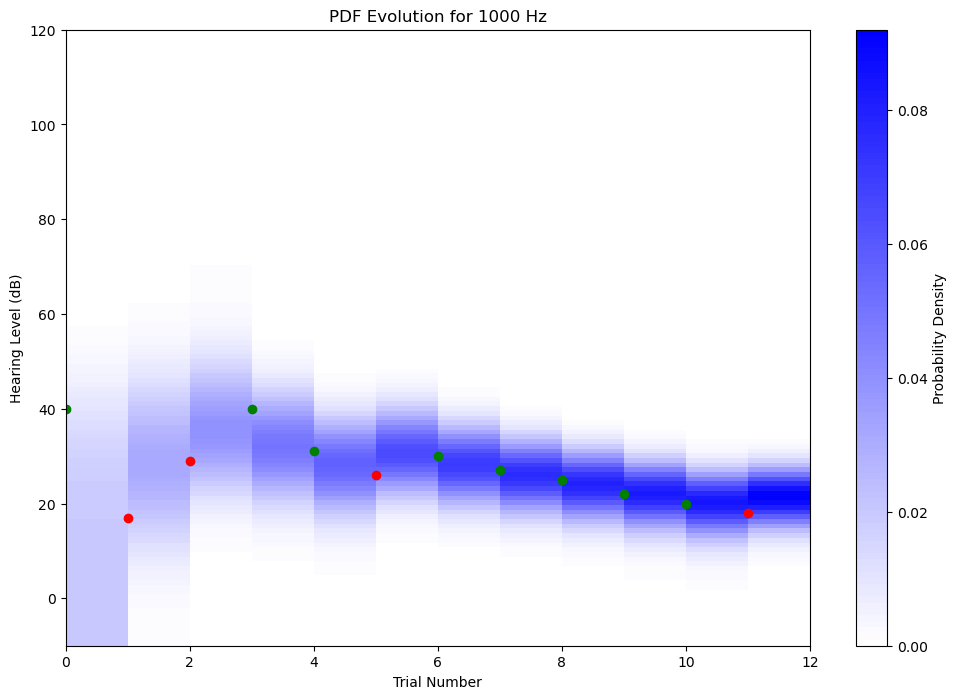

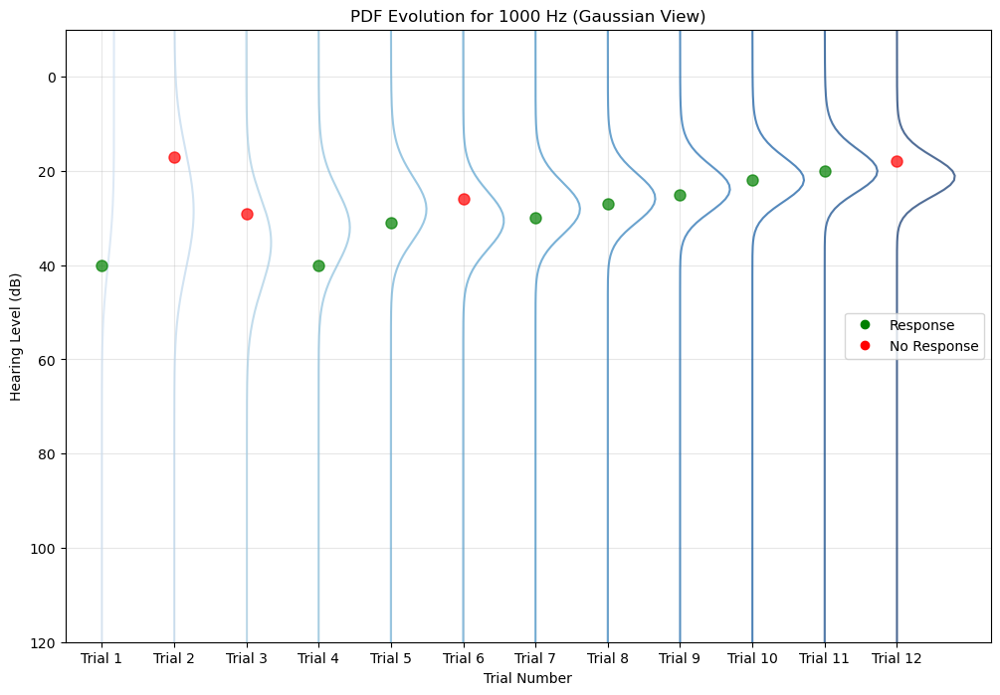

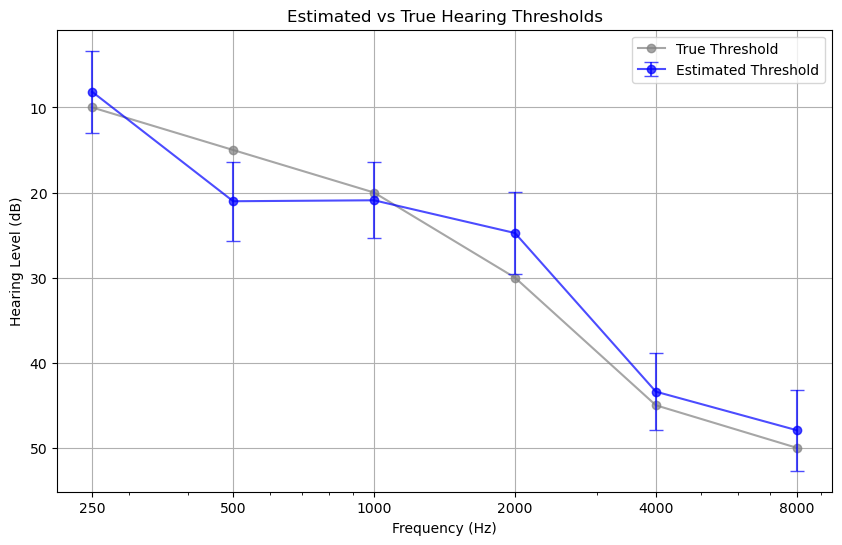


Comparison of True vs Estimated Thresholds:
Frequency | True  | Estimated | Difference | Uncertainty
------------------------------------------------------------
     250 |    10 |       8.2 |      -1.8 | ±     4.8
     500 |    15 |      21.0 |      +6.0 | ±     4.7
    1000 |    20 |      20.9 |      +0.9 | ±     4.5
    2000 |    30 |      24.8 |      -5.2 | ±     4.8
    4000 |    45 |      43.4 |      -1.6 | ±     4.5
    8000 |    50 |      47.9 |      -2.1 | ±     4.8

Summary Statistics:
Mean difference: -0.6 dB
Standard deviation of differences: 3.5 dB
Maximum absolute difference: 6.0 dB
Mean uncertainty: 4.7 dB


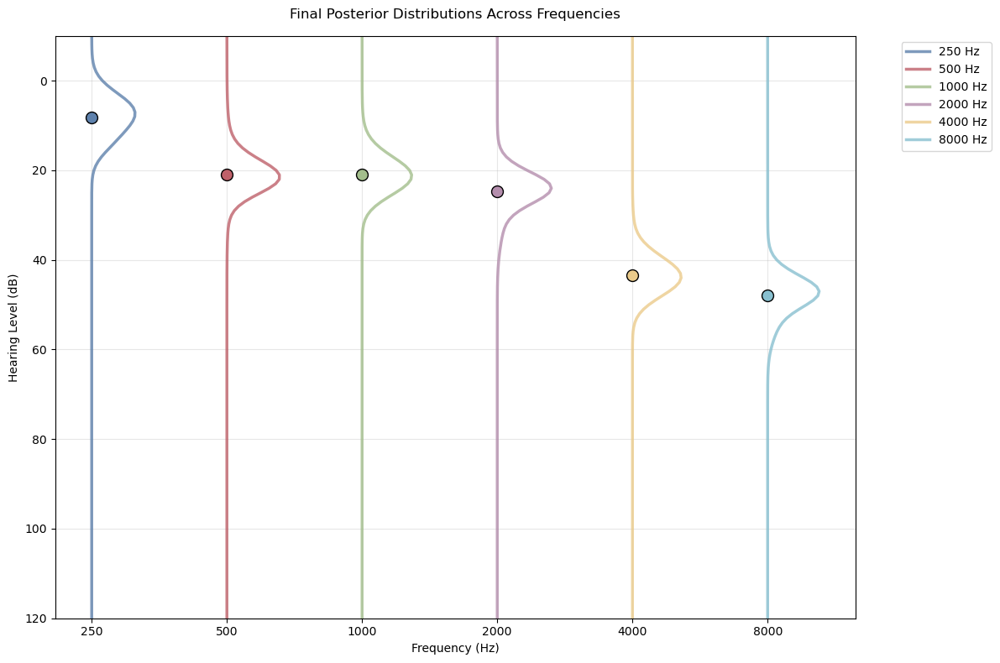

In [8]:
"""Example usage of the Bayesian audiometry testing system with enhanced visualizations."""

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

def plot_audiogram(thresholds, uncertainties, true_thresholds, title="Bayesian Audiogram"):
    """
    Plot audiogram with both estimated and true thresholds.
    
    Args:
        thresholds: Dictionary of estimated thresholds
        uncertainties: Dictionary of threshold uncertainties
        true_thresholds: Dictionary of true thresholds
        title: Plot title
    """
    frequencies = sorted(thresholds.keys())
    est_levels = [thresholds[f] for f in frequencies]
    true_levels = [true_thresholds[f] for f in frequencies]
    errors = [uncertainties[f] for f in frequencies]
    
    plt.figure(figsize=(10, 6))
    
    # Plot true thresholds
    plt.plot(frequencies, true_levels, 'o-', color='gray', label='True Threshold', alpha=0.7)
    
    # Plot estimated thresholds with uncertainty
    plt.errorbar(frequencies, est_levels, yerr=errors, fmt='bo-', capsize=5, 
                label='Estimated Threshold', alpha=0.7)
    
    plt.xscale('log')
    plt.xticks(frequencies, frequencies)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Hearing Level (dB)')
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.gca().invert_yaxis()
    plt.show()

def plot_pdf_evolution(pdf_history, db_range, frequency, progression):
    """Plot evolution of probability distribution for a specific frequency."""
    plt.figure(figsize=(12, 8))
    
    # Create custom colormap from white to blue
    colors = [(1, 1, 1), (0, 0, 1)]
    n_bins = 100
    cmap = LinearSegmentedColormap.from_list("custom", colors, N=n_bins)
    
    # Plot PDF evolution as heatmap
    plt.imshow(
        np.array(pdf_history).T,
        aspect='auto',
        extent=[0, len(pdf_history), db_range[0], db_range[-1]],
        origin='lower',
        cmap=cmap
    )
    
    # Plot test levels
    test_levels = [p[0] for p in progression]
    responses = [p[1] for p in progression]
    for i, (level, response) in enumerate(zip(test_levels, responses)):
        color = 'g' if response else 'r'
        plt.plot(i, level, color + 'o')
    
    plt.colorbar(label='Probability Density')
    plt.title(f'PDF Evolution for {frequency} Hz')
    plt.xlabel('Trial Number')
    plt.ylabel('Hearing Level (dB)')
    plt.show()

def plot_pdf_evolution_gaussians(pdf_history, db_range, frequency, progression, n_trials_to_show=None):
    """
    Plot evolution of probability distribution as series of vertical Gaussians.
    
    Args:
        pdf_history: List of PDFs over time
        db_range: Range of dB values
        frequency: Test frequency
        progression: List of test progression data
        n_trials_to_show: Number of trials to show (None for all)
    """
    plt.figure(figsize=(12, 8))
    
    # Select trials to show
    if n_trials_to_show is None:
        n_trials_to_show = len(pdf_history)
    step = max(1, len(pdf_history) // n_trials_to_show)
    selected_pdfs = pdf_history[::step]
    selected_progression = progression[::step]
    
    # Create colormap from light to dark blue
    colors = plt.cm.Blues(np.linspace(0.2, 1, len(selected_pdfs)))
    
    # Calculate maximum density for scaling
    max_density = max(max(pdf) for pdf in selected_pdfs)
    
    # Determine plot width needed for PDFs
    pdf_width = 0.8  # Width of PDF relative to trial spacing
    
    # Plot each PDF vertically
    for i, (pdf, color, prog) in enumerate(zip(selected_pdfs, colors, selected_progression)):
        # Scale PDF for visualization
        scaled_pdf = pdf / max_density * pdf_width
        
        # Plot vertical PDF
        plt.plot(i + scaled_pdf, db_range, color=color, alpha=0.7)
        
        # Add test point
        level, response = prog[0], prog[1]
        marker = 'go' if response else 'ro'
        plt.plot(i, level, marker, markersize=8, alpha=0.7)
    
    # Customize plot
    plt.grid(True, alpha=0.3)
    plt.title(f'PDF Evolution for {frequency} Hz (Gaussian View)')
    plt.ylabel('Hearing Level (dB)')
    plt.xlabel('Trial Number')
    
    # Add legend for markers
    plt.plot([], [], 'go', label='Response')
    plt.plot([], [], 'ro', label='No Response')
    plt.legend()
    
    # Set x-axis limits to include space for final PDF
    plt.xlim(-0.5, len(selected_pdfs) - 0.5 + pdf_width)
    plt.xticks(range(len(selected_pdfs)), 
               [f'Trial {i*step + 1}' for i in range(len(selected_pdfs))])
    
    # Set y-axis limits to match db_range
    plt.ylim(db_range[0], db_range[-1])
    
    # Invert y-axis to match audiogram convention
    plt.gca().invert_yaxis()
    
    plt.show()

import numpy as np
import matplotlib.pyplot as plt

import numpy as np
import matplotlib.pyplot as plt

def plot_final_pdfs(posteriors, db_range, thresholds, frequencies=None):
    """
    Plot final PDFs for all test frequencies using distinct Nord colors.
    Args:
        posteriors (dict): Dictionary mapping frequencies to final posterior distributions
        db_range (array): Range of dB values used in the test
        thresholds (dict): Dictionary mapping frequencies to estimated thresholds
        frequencies (list, optional): List of frequencies to plot. If None, uses all frequencies in posteriors
    """
    # Nord palette colors (using more distinct colors from the palette)
    nord_colors = [
        '#5E81AC',  # Nord Frost 0 (Blue)
        '#BF616A',  # Nord Red
        '#A3BE8C',  # Nord Green
        '#B48EAD',  # Nord Purple
        '#EBCB8B',  # Nord Yellow
        '#88C0D0',  # Nord Frost 2 (Light Blue)
        '#D08770',  # Nord Orange
        '#81A1C1',  # Nord Frost 1 (Another Blue)
    ]

    plt.figure(figsize=(12, 8))
    if frequencies is None:
        frequencies = sorted(posteriors.keys())
    
    # Create color list based on number of frequencies
    num_freqs = len(frequencies)
    if num_freqs <= len(nord_colors):
        colors = nord_colors[:num_freqs]
    else:
        # If more frequencies than colors, cycle through the colors
        colors = [nord_colors[i % len(nord_colors)] for i in range(num_freqs)]

    # Calculate maximum density for scaling
    max_density = max(max(pdf) for pdf in posteriors.values())
    pdf_width = 0.4  # Width of PDF relative to frequency spacing

    # Convert frequencies to log scale positions for plotting
    log_freqs = np.log2(frequencies)
    plot_positions = log_freqs - min(log_freqs)
    spacing = 1.0  # Space between frequencies in plot units
    plot_positions = plot_positions * spacing

    # Plot each frequency's PDF
    for freq, pos, color in zip(frequencies, plot_positions, colors):
        # Get and scale the PDF
        pdf = posteriors[freq]
        scaled_pdf = pdf / max_density * pdf_width
        
        # Plot vertical PDF with increased line width
        plt.plot(pos + scaled_pdf, db_range, color=color, alpha=0.8,
                label=f'{freq} Hz', linewidth=2.5)
        
        # Plot threshold point with matching color and increased size
        threshold = thresholds[freq]
        plt.plot(pos, threshold, 'o', color=color, markersize=10, 
                markeredgecolor='black', markeredgewidth=1)

    # Customize plot
    plt.grid(True, alpha=0.3)
    plt.title('Final Posterior Distributions Across Frequencies', 
             fontsize=12, pad=15)
    plt.ylabel('Hearing Level (dB)')
    plt.xlabel('Frequency (Hz)')
    
    # Set x-axis ticks to show frequencies
    plt.xticks(plot_positions, frequencies)
    
    # Set y-axis limits and invert
    plt.ylim(db_range[0], db_range[-1])
    plt.gca().invert_yaxis()
    
    # Add legend
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Adjust layout to prevent label cutoff
    plt.tight_layout()
    
    return plt.gca()

def print_progression(progression, frequency):
    """Print detailed progression for a specific frequency."""
    print(f"\nProgression for {frequency} Hz:")
    print("Level | Response | Est. Threshold | Uncertainty | Phase")
    print("-" * 65)
    for level, response, threshold, uncertainty, phase in progression:
        print(f"{level:3.0f} dB | {str(response):5} | {threshold:13.1f} | {uncertainty:10.1f} | {phase}")

def main():
    # Create simulated hearing profile with mild to moderate hearing loss
    hearing_profile = {
        250: 10,   
        500: 15,   
        1000: 20,  
        2000: 30,  
        4000: 45,  
        8000: 50   
    }

    # Configure response model
    response_params = {
        'slope': 0.2,      
        'guess_rate': 0.01,  
        'lapse_rate': 0.01   
    }

    # Initialize and run test
    audiometry = BayesianPureToneAudiometry(
        hearing_profile_data=hearing_profile,
        response_model_params=response_params,
        test_frequencies=[1000, 2000, 4000, 8000, 500, 250],
        random_state=42,
        fp_rate=0.01,
        fn_rate=0.02
    )

    # Get results
    results = audiometry.perform_test()
    thresholds = results['thresholds']
    uncertainties = results['uncertainties']
    progression_patterns = results['progression_patterns']
    pdf_histories = results['pdf_history']

    # Print results
    print("\nTest Results:")
    print("\nThresholds (with uncertainties):")
    for freq in sorted(thresholds.keys()):
        print(f"{freq} Hz: {thresholds[freq]:.1f} dB ± {uncertainties[freq]:.1f} dB")

    # Calculate and print trial statistics
    print("\nTrials per Frequency:")
    print("Frequency | Trials")
    print("-" * 20)
    trials_per_freq = [len(prog) for prog in progression_patterns.values()]
    mean_trials = np.mean(trials_per_freq)
    std_trials = np.std(trials_per_freq)
    
    for freq in sorted(progression_patterns.keys()):
        n_trials = len(progression_patterns[freq])
        print(f"{freq:8d} | {n_trials:6d}")
    
    print("\nTrial Statistics:")
    print(f"Mean trials per frequency: {mean_trials:.1f}")
    print(f"Standard deviation: {std_trials:.1f}")
    print(f"Range: {min(trials_per_freq)} - {max(trials_per_freq)}")

    # Print detailed progression for 1000 Hz as example
    print_progression(progression_patterns[1000], 1000)

    # Plot both visualizations for 1000 Hz
    plot_pdf_evolution(
        pdf_histories[1000],
        audiometry.db_range,
        1000,
        progression_patterns[1000]
    )
    
    plot_pdf_evolution_gaussians(
        pdf_histories[1000],
        audiometry.db_range,
        1000,
        progression_patterns[1000],
        n_trials_to_show=10  # Show 10 trials for clarity
    )

    # Plot audiogram with both true and estimated thresholds
    plot_audiogram(thresholds, uncertainties, hearing_profile, 
                  "Estimated vs True Hearing Thresholds")
    
    plot_final_pdfs(
    posteriors={f: pdf_histories[f][-1] for f in thresholds.keys()},
    db_range=audiometry.db_range,
    thresholds=thresholds)

    # Print comparison statistics
    print("\nComparison of True vs Estimated Thresholds:")
    print("Frequency | True  | Estimated | Difference | Uncertainty")
    print("-" * 60)
    for freq in sorted(thresholds.keys()):
        true_val = hearing_profile[freq]
        est_val = thresholds[freq]
        diff = est_val - true_val
        uncert = uncertainties[freq]
        print(f"{freq:8d} | {true_val:5d} | {est_val:9.1f} | {diff:+9.1f} | ±{uncert:8.1f}")

    # Print summary statistics
    diffs = [thresholds[f] - hearing_profile[f] for f in thresholds.keys()]
    mean_diff = np.mean(diffs)
    std_diff = np.std(diffs)
    mean_uncert = np.mean(list(uncertainties.values()))
    
    print("\nSummary Statistics:")
    print(f"Mean difference: {mean_diff:.1f} dB")
    print(f"Standard deviation of differences: {std_diff:.1f} dB")
    print(f"Maximum absolute difference: {max(abs(d) for d in diffs):.1f} dB")
    print(f"Mean uncertainty: {mean_uncert:.1f} dB")

if __name__ == "__main__":
    main()

In [3]:
def plot_final_pdfs(posteriors, db_range, thresholds, frequencies=None):
    """
    Plot final PDFs for all test frequencies.
    
    Args:
        posteriors (dict): Dictionary mapping frequencies to final posterior distributions
        db_range (array): Range of dB values used in the test
        thresholds (dict): Dictionary mapping frequencies to estimated thresholds
        frequencies (list, optional): List of frequencies to plot. If None, uses all frequencies in posteriors
    """
    plt.figure(figsize=(12, 8))
    
    if frequencies is None:
        frequencies = sorted(posteriors.keys())
    
    # Create custom colormap from light to dark blue
    colors = plt.cm.Blues(np.linspace(0.4, 1, len(frequencies)))
    
    # Calculate maximum density for scaling
    max_density = max(max(pdf) for pdf in posteriors.values())
    pdf_width = 0.4  # Width of PDF relative to frequency spacing
    
    # Convert frequencies to log scale positions for plotting
    log_freqs = np.log2(frequencies)
    plot_positions = log_freqs - min(log_freqs)
    spacing = 1.0  # Space between frequencies in plot units
    plot_positions = plot_positions * spacing
    
    # Plot each frequency's PDF
    for freq, pos, color in zip(frequencies, plot_positions, colors):
        # Get and scale the PDF
        pdf = posteriors[freq]
        scaled_pdf = pdf / max_density * pdf_width
        
        # Plot vertical PDF
        plt.plot(pos + scaled_pdf, db_range, color=color, alpha=0.7, 
                label=f'{freq} Hz')
        
        # Plot threshold point
        threshold = thresholds[freq]
        plt.plot(pos, threshold, 'ko', markersize=8)
    
    # Customize plot
    plt.grid(True, alpha=0.3)
    plt.title('Final Posterior Distributions Across Frequencies')
    plt.ylabel('Hearing Level (dB)')
    plt.xlabel('Frequency (Hz)')
    
    # Set x-axis ticks to show frequencies
    plt.xticks(plot_positions, frequencies)
    
    # Set y-axis limits and invert
    plt.ylim(db_range[0], db_range[-1])
    plt.gca().invert_yaxis()
    
    # Add legend
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Adjust layout to prevent label cutoff
    plt.tight_layout()
    
    return plt.gca()

In [4]:
plot_final_pdfs(
    posteriors={f: pdf_histories[f][-1] for f in thresholds.keys()},
    db_range=audiometry.db_range,
    thresholds=thresholds
)

NameError: name 'thresholds' is not defined

In [43]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def animate_pdf_evolution_trials(pdf_history, db_range, frequency, progression):
    """
    Animate the evolution of probability distribution across trials.
    
    Args:
        pdf_history: List of PDFs over time
        db_range: Range of dB values
        frequency: Test frequency
        progression: List of test progression data
    
    Returns:
        HTML animation for display in Jupyter notebook
    """
    # Add uniform prior as the first PDF
    uniform_prior = np.ones_like(db_range) / len(db_range)
    all_pdfs = [uniform_prior] + pdf_history
    
    # Setup figure and axes
    fig, ax = plt.subplots(figsize=(14, 8))
    
    # Create color gradients from light to dark blue
    pdf_colors = plt.cm.Blues(np.linspace(0.4, 1.0, len(all_pdfs)))
    
    # Calculate maximum density for scaling
    max_density = max(max(pdf) for pdf in all_pdfs)
    pdf_width = 0.8  # Width of PDF relative to trial spacing
    
    # Define x positions for trials
    trial_positions = np.arange(len(all_pdfs))
    
    # Label for the baseline and trials
    trial_labels = ["Baseline"] + [f"Trial {i+1}" for i in range(len(progression))]
    
    # Set up axis limits and labels
    ax.set_xlim(-0.5, len(all_pdfs) - 0.5 + pdf_width)
    ax.set_ylim(db_range[0], db_range[-1])
    ax.set_yticks(np.arange(0, 121, 20))  # Adjust y ticks for readability
    ax.invert_yaxis()  # Invert y-axis to match audiogram convention
    ax.set_xticks(trial_positions)
    ax.set_xticklabels(trial_labels, rotation=45, ha='right')
    ax.grid(True, alpha=0.3)
    ax.set_title(f'Bayesian Audiometry Process for {frequency} Hz', fontsize=14)
    ax.set_ylabel('Hearing Level (dB)', fontsize=12)
    ax.set_xlabel('Trial Progression', fontsize=12)
    
    # Add legend for response markers
    ax.plot([], [], 'go', markersize=8, label='Response')
    ax.plot([], [], 'ro', markersize=8, label='No Response')
    ax.plot([], [], 'ko', markersize=8, label='Test Level')
    ax.legend(loc='upper right')
    
    # Initialize containers for plotting objects
    pdf_curves = []  # Will store all PDF lines
    test_point = plt.Line2D([], [], marker='o', color='k', markersize=8, linestyle='None')
    ax.add_line(test_point)
    
    # Add a text box for status updates
    status_text = ax.text(0.02, 0.02, '', transform=ax.transAxes, fontsize=12, 
                         bbox=dict(facecolor='white', alpha=0.7))
    
    # Animation parameters - phases in correct order
    PHASE_PRESENTING = 0      # Presenting test level (pulsating dot)
    PHASE_PAUSE_AFTER_TEST = 1  # Pause after test (steady dot)
    PHASE_RESPONDING = 2      # Showing response (pulsating colored dot)
    PHASE_PAUSE_AFTER_RESP = 3  # Pause after response (steady colored dot)
    PHASE_TRANSITIONING = 4   # Moving PDF to new position
    PHASE_PAUSE_AFTER_TRANS = 5  # Pause after transition (show new PDF)
    
    # Customize timing for each phase
    frames_per_presenting = 15     # Pulsating test dot
    frames_per_pause_test = 15     # Pause after test (about 2 seconds)
    frames_per_responding = 15     # Pulsating response dot
    frames_per_pause_resp = 15     # Pause after response (about 2 seconds)
    frames_per_transition = 30     # PDF transition (about 4 seconds)
    frames_per_pause_trans = 15    # Pause after transition (about 2 seconds)
    
    # Calculate total frames per trial based on the sequence of phases
    phase_frames = [
        frames_per_presenting,
        frames_per_pause_test,
        frames_per_responding,
        frames_per_pause_resp,
        frames_per_transition,
        frames_per_pause_trans
    ]
    
    frames_per_trial = sum(phase_frames)
    total_frames = (len(progression)) * frames_per_trial + phase_frames[0]  # Add initial presentation
    
    def init():
        # Initialize with baseline PDF
        pdf_curves.clear()
        
        # Add baseline uniform PDF
        baseline_pdf = all_pdfs[0]
        scaled_pdf = baseline_pdf / max_density * pdf_width
        curve, = ax.plot(0 + scaled_pdf, db_range, color=pdf_colors[0], alpha=0.7, linewidth=2)
        pdf_curves.append(curve)
        
        test_point.set_data([], [])
        status_text.set_text('Initial Uniform Prior - Starting Test')
        
        return pdf_curves + [test_point, status_text]
    
    def get_phase_info(frame_idx):
        """
        Helper function to determine trial index, phase, and progress within phase.
        Returns (trial_idx, phase, progress_in_phase)
        """
        # Special case for frame 0 (starting point)
        if frame_idx == 0:
            return 0, None, 0
            
        frame_idx -= 1  # Adjust for the initial frame
        
        # Calculate which trial we're in
        trial_idx = frame_idx // frames_per_trial
        frame_in_trial = frame_idx % frames_per_trial
        
        # Determine which phase within the trial
        phase_idx = 0
        remaining_frames = frame_in_trial
        
        while phase_idx < len(phase_frames) and remaining_frames >= phase_frames[phase_idx]:
            remaining_frames -= phase_frames[phase_idx]
            phase_idx += 1
            
        # Calculate progress within this phase (0.0 to 1.0)
        if phase_idx < len(phase_frames):
            progress = remaining_frames / phase_frames[phase_idx]
        else:
            progress = 1.0  # Failsafe
            
        return trial_idx + 1, phase_idx, progress  # +1 because trial 0 is baseline
    
    def animate(frame_idx):
        # Get trial number, phase, and progress within phase
        trial_num, phase, phase_progress = get_phase_info(frame_idx)
        
        # Clear previous PDF curves
        for curve in pdf_curves:
            if curve in ax.lines:
                curve.remove()
        pdf_curves.clear()
        
        # Always draw all completed trials' PDFs
        for i in range(trial_num):
            # Skip drawing the current trial only during active transition
            if i == trial_num - 1 and phase == PHASE_TRANSITIONING and trial_num < len(all_pdfs):
                # Previous trial transitions to current, so we'll handle it separately
                continue
                
            pdf = all_pdfs[i]
            scaled_pdf = pdf / max_density * pdf_width
            alpha = 0.8 if i == trial_num - 1 else 0.5  # Highlight current trial
            curve, = ax.plot(i + scaled_pdf, db_range, color=pdf_colors[i], alpha=alpha, linewidth=2)
            pdf_curves.append(curve)
        
        # Special handling for initial frame (baseline)
        if trial_num == 0 or phase is None:
            test_point.set_data([], [])
            status_text.set_text('Initial Uniform Prior - Starting Test')
            return pdf_curves + [test_point, status_text]
        
        # Handle animation for current trial
        if trial_num <= len(progression):
            # Get current trial data
            current_progression = progression[trial_num-1]
            level = current_progression[0]
            response = current_progression[1]
            response_color = 'g' if response else 'r'
            phase_name = current_progression[4]
            
            # Handle different phases
            if phase == PHASE_PRESENTING:
                # Phase 1: Presenting test level (pulsating dot)
                pulse_size = 8 + 4 * np.sin(phase_progress * 2 * np.pi)
                test_point.set_markersize(pulse_size)
                test_point.set_markerfacecolor('k')
                test_point.set_markeredgecolor('k')
                test_point.set_data([trial_num], [level])
                
                status_text.set_text(f'Trial {trial_num}: Testing at {level:.0f} dB...\nPhase: {phase_name}')
                
            elif phase == PHASE_PAUSE_AFTER_TEST:
                # Phase 2: Pause after test (steady black dot)
                test_point.set_markersize(8)
                test_point.set_markerfacecolor('k')
                test_point.set_markeredgecolor('k')
                test_point.set_data([trial_num], [level])
                
                status_text.set_text(f'Trial {trial_num}: Awaiting response...\nPhase: {phase_name}')
                
            elif phase == PHASE_RESPONDING:
                # Phase 3: Showing response (pulsating colored dot)
                pulse_size = 8 + 4 * np.sin(phase_progress * 2 * np.pi)
                test_point.set_markersize(pulse_size)
                test_point.set_markerfacecolor(response_color)
                test_point.set_markeredgecolor(response_color)
                test_point.set_data([trial_num], [level])
                
                response_text = "Response detected" if response else "No response"
                status_text.set_text(f'Trial {trial_num}: {level:.0f} dB - {response_text}\nPhase: {phase_name}')
                
            elif phase == PHASE_PAUSE_AFTER_RESP:
                # Phase 4: Pause after response (steady colored dot)
                test_point.set_markersize(8)
                test_point.set_markerfacecolor(response_color)
                test_point.set_markeredgecolor(response_color)
                test_point.set_data([trial_num], [level])
                
                response_text = "Response detected" if response else "No response"
                status_text.set_text(f'Trial {trial_num}: {level:.0f} dB - {response_text}\nPhase: {phase_name}')
                
            elif phase == PHASE_TRANSITIONING and trial_num < len(all_pdfs):
                # Phase 5: Transitioning PDF from previous to current position
                # Keep the response dot visible
                test_point.set_markersize(8)
                test_point.set_markerfacecolor(response_color)
                test_point.set_markeredgecolor(response_color)
                test_point.set_data([trial_num], [level])
                
                # Get the PDFs for the previous and current trials
                prev_pdf = all_pdfs[trial_num-1]
                curr_pdf = all_pdfs[trial_num]
                
                # Create the transitioning PDF - interpolate shapes
                transition_pdf = prev_pdf * (1 - phase_progress) + curr_pdf * phase_progress
                
                # Calculate x positions
                x_prev = trial_num - 1
                x_curr = trial_num
                x_pos = x_prev * (1 - phase_progress) + x_curr * phase_progress
                
                # Draw the previous trial's PDF at its fixed position with FIXED opacity
                scaled_prev_pdf = prev_pdf / max_density * pdf_width
                prev_curve, = ax.plot(x_prev + scaled_prev_pdf, db_range,
                                   color=pdf_colors[trial_num-1],
                                   alpha=0.5, linewidth=2)  # Use constant alpha of 0.5
                pdf_curves.append(prev_curve)
                
                # Draw the transitioning PDF
                scaled_transition_pdf = transition_pdf / max_density * pdf_width
                transition_curve, = ax.plot(x_pos + scaled_transition_pdf, db_range,
                                         color=pdf_colors[trial_num],
                                         alpha=0.8, linewidth=2.5)
                pdf_curves.append(transition_curve)
                
                threshold_est = current_progression[2]
                uncertainty = current_progression[3]
                status_text.set_text(f'Updating model based on response...\n'
                                   f'Current estimate: {threshold_est:.1f} dB ± {uncertainty:.1f} dB')
                
            elif phase == PHASE_PAUSE_AFTER_TRANS:
                # Phase 6: Pause after transition - show the new PDF
                test_point.set_markersize(8)
                test_point.set_markerfacecolor(response_color)
                test_point.set_markeredgecolor(response_color)
                test_point.set_data([trial_num], [level])
                
                # Make sure to explicitly draw the current trial's PDF
                if trial_num < len(all_pdfs):
                    # Draw the current trial's PDF at its final position
                    curr_pdf = all_pdfs[trial_num]
                    scaled_curr_pdf = curr_pdf / max_density * pdf_width
                    curr_curve, = ax.plot(trial_num + scaled_curr_pdf, db_range,
                                       color=pdf_colors[trial_num],
                                       alpha=0.8, linewidth=2.5)
                    pdf_curves.append(curr_curve)
                
                threshold_est = current_progression[2]
                uncertainty = current_progression[3]
                status_text.set_text(f'Updated threshold estimate: {threshold_est:.1f} dB ± {uncertainty:.1f} dB\n'
                                   f'Preparing for next trial...')
                
        # Final trial - show completion
        if trial_num == len(progression) and phase > PHASE_PRESENTING:
            final_progression = progression[-1]
            final_threshold = final_progression[2]
            final_uncertainty = final_progression[3]
            
            status_text.set_text(f'Test Complete!\nFinal Threshold: {final_threshold:.1f} dB\n'
                               f'Uncertainty: ±{final_uncertainty:.1f} dB')
        
        return pdf_curves + [test_point, status_text]
    
    # Create animation
    anim = FuncAnimation(
        fig, 
        animate, 
        frames=total_frames,
        init_func=init,
        blit=True,
        interval=60
    )
    
    plt.tight_layout()
    plt.close()  # Prevent double display in notebooks
    
    # Return both the animation object and HTML
    return (anim, HTML(anim.to_html5_video()))  # Return both for different uses

In [19]:
# Create simulated hearing profile with mild to moderate hearing loss
hearing_profile = {
    250: 10,   
    500: 15,   
    1000: 20,  
    2000: 30,  
    4000: 45,  
    8000: 50   
}

# Configure response model
response_params = {
    'slope': 0.2,      
    'guess_rate': 0.01,  
    'lapse_rate': 0.01   
}

# Initialize and run test
audiometry = BayesianPureToneAudiometry(
    hearing_profile_data=hearing_profile,
    response_model_params=response_params,
    test_frequencies=[1000, 2000, 4000, 8000, 500, 250],
    random_state=42,
    fp_rate=0.01,
    fn_rate=0.02
)

# Get results
results = audiometry.perform_test()
thresholds = results['thresholds']
uncertainties = results['uncertainties']
progression_patterns = results['progression_patterns']
pdf_histories = results['pdf_history']

# Print results
print("\nTest Results:")
print("\nThresholds (with uncertainties):")
for freq in sorted(thresholds.keys()):
    print(f"{freq} Hz: {thresholds[freq]:.1f} dB ± {uncertainties[freq]:.1f} dB")

# Calculate and print trial statistics
print("\nTrials per Frequency:")
print("Frequency | Trials")
print("-" * 20)
trials_per_freq = [len(prog) for prog in progression_patterns.values()]
mean_trials = np.mean(trials_per_freq)
std_trials = np.std(trials_per_freq)

for freq in sorted(progression_patterns.keys()):
    n_trials = len(progression_patterns[freq])
    print(f"{freq:8d} | {n_trials:6d}")

print("\nTrial Statistics:")
print(f"Mean trials per frequency: {mean_trials:.1f}")
print(f"Standard deviation: {std_trials:.1f}")
print(f"Range: {min(trials_per_freq)} - {max(trials_per_freq)}")

# Print detailed progression for 1000 Hz as example
print_progression(progression_patterns[1000], 1000)


Test Results:

Thresholds (with uncertainties):
250 Hz: 8.2 dB ± 4.8 dB
500 Hz: 21.0 dB ± 4.7 dB
1000 Hz: 20.9 dB ± 4.5 dB
2000 Hz: 24.8 dB ± 4.8 dB
4000 Hz: 43.4 dB ± 4.5 dB
8000 Hz: 47.9 dB ± 4.8 dB

Trials per Frequency:
Frequency | Trials
--------------------
     250 |     12
     500 |      5
    1000 |     12
    2000 |      6
    4000 |     12
    8000 |     10

Trial Statistics:
Mean trials per frequency: 9.5
Standard deviation: 2.9
Range: 5 - 12

Progression for 1000 Hz:
Level | Response | Est. Threshold | Uncertainty | Phase
-----------------------------------------------------------------
 40 dB | True  |          16.8 |       18.2 | descending
 17 dB | False |          29.7 |       16.0 | ascending
 29 dB | False |          38.6 |       15.7 | ascending
 40 dB | True  |          31.8 |        8.5 | descending
 31 dB | True  |          27.5 |        7.4 | descending
 26 dB | False |          30.5 |        6.3 | ascending
 30 dB | True  |          27.8 |        5.8 | descen

In [44]:
# Create and display the animation
anim_obj, animation_html = animate_pdf_evolution_trials(
    pdf_histories[1000],
    audiometry.db_range,
    1000,
    progression_patterns[1000]
)

# Display in notebook
animation_html

In [51]:
# Get the HTML with controls
html_content = anim_obj.to_jshtml()

# Save to file
with open('bayesian_audiometry_animation.html', 'w') as f:
    f.write(html_content)

# Display in notebook
HTML(html_content)

In [53]:
# Example using Playwright to record the animation
from playwright.sync_api import sync_playwright
import time

def html_to_mp4(html_path, output_mp4_path, width=1920, height=1080, duration=30):
    with sync_playwright() as p:
        browser = p.chromium.launch()
        context = browser.new_context(
            viewport={'width': width, 'height': height},
            record_video_dir="./",
            record_video_size={'width': width, 'height': height}
        )
        page = context.new_page()
        page.goto(f"file://{html_path}")
        
        # Allow animation to play
        time.sleep(duration)
        
        # Close browser and save video
        context.close()
        browser.close()
        
        # Rename the video file
        import os
        video_files = [f for f in os.listdir("./") if f.endswith(".webm")]
        if video_files:
            os.rename(video_files[0], output_mp4_path)
            
# Usage
html_to_mp4("bayesian_audiometry_animation.html", 
           "bayesian_audiometry_animation.mp4")

Error: It looks like you are using Playwright Sync API inside the asyncio loop.
Please use the Async API instead.